# Wczytywanie danych w sparku

Utworzenie środowiska pyspark do obliczeń:

In [ ]:
!apt-get install openjdk-8-jdk-headless -qq > /dev/null
!wget -q dlcdn.apache.org/spark/spark-3.5.0/spark-3.5.0-bin-hadoop3.tgz
!tar xf spark-3.5.0-bin-hadoop3.tgz
!pip install -q findspark

In [ ]:
import os
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
os.environ["SPARK_HOME"] = "/content/spark-3.5.0-bin-hadoop3"

In [ ]:
import findspark
findspark.init()

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import pandas as pd
from google.colab import drive
from pyspark.sql import SparkSession
from pyspark.sql import DataFrame as SparkDataFrame
from pyspark.sql.types import IntegerType, FloatType, StringType, StructType
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import warnings
warnings.filterwarnings('ignore')

Utowrzenie sesji:

In [ ]:
spark = SparkSession.builder\
        .master("local")\
        .appName("Colab")\
        .config('spark.ui.port', '4050')\
        .getOrCreate()

Połączenie z dyskiem:

In [ ]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Wczytanie danych NASA znajdujących się na dysku w sparku:

In [ ]:
columns = ['lon', 'lat', 'Date', 'Rainf', 'Evap', 'AvgSurfT', 'Albedo','SoilT_10_40cm', 'GVEG', 'PotEvap', 'RootMoist', 'SoilM_100_200cm']

# Utworzenie schematu określającego typ zmiennych
schema = StructType()
for i in columns:
  if i == "Date":
    schema = schema.add(i, IntegerType(), True)
  else:
    schema = schema.add(i, FloatType(), True)

In [ ]:
# Wczytanie zbioru Nasa w sparku
nasa = spark.read.format('csv').option("header", True).schema(schema).load('/content/drive/MyDrive/BigMess/NASA/NASA.csv')

Zanim zaczniemy pisać kwerendy należy jeszcze dodać nasz DataFrame (df) do "przestrzeni nazw tabel" Sparka:

In [ ]:
nasa.createOrReplaceTempView("nasa")

Rozdzielenie kolumny "Date" na kolumny "Year" oraz "Month"

In [ ]:
nasa_ym = spark.sql("""
          SELECT
          CAST(SUBSTRING(CAST(Date AS STRING), 1, 4) AS INT) AS Year,
          CAST(SUBSTRING(CAST(Date AS STRING), 5, 2) AS INT) AS Month,
          n.*
          FROM nasa n
          """)
nasa_ym = nasa_ym.drop("Date")

In [ ]:
nasa_ym.createOrReplaceTempView("nasa_ym")

# Grupowanie k-średnich

In [ ]:
def MinMaxScaling(df: pd.DataFrame, attributes: list) -> pd.DataFrame:
  """
  Funkcja służąca do przeskalowania wybranych atrybutów za pomocą funkcji MinMaxScaler, a następnie stworzenia nowej ramki danych z tylko przeskalowanymi atrybutami.
  Parametry:
  - df (DataFrame): Pandas DataFrame zawierająca co najmniej atrybuty,
  - attributes (str): atrybuty, które będziemy skalować.
  """
  scaled_data = MinMaxScaler().fit_transform(df[attributes])
  scaled_df = pd.DataFrame(scaled_data, columns=attributes)
  return scaled_df

In [ ]:
def plot_kmeans(scaled_df: pd.DataFrame, n_clusters: int, random_state: int) -> None:
  """
  Funkcja wykonuje grupowanie k-średnich dla 1, 2 ..., n_clusters klastrów oraz tworzy wykres przedstawiający wartości inercji w zależności od zadanej liczby klastrów.
  Parametry:
  - scaled_df (DataFrame): Pandas DataFrame zawierająca przeskalowane kolumny, na podstawie których dokonywane jest grupowanie,
  - n_clusters (int): maksymalna liczba klastrów,
  - random_state (int): ziarno losowości.
  """
  # Wykonanie algorytmu k-średnich dla n_clusters i zapisanie wyników
  SSE = []
  for cluster in range(1, n_clusters):
      kmeans = KMeans(n_clusters = cluster, init='k-means++', random_state=random_state)
      kmeans.fit(scaled_df)
      SSE.append(kmeans.inertia_)

  # Przedstawienie wartości na wykresie
  plt.figure(figsize=(12,6))
  plt.plot(range(1, n_clusters), SSE)
  plt.xlabel('Liczba klastrów')
  plt.ylabel('Suma wariancji')
  plt.title('Wybór optymalnej liczby klastrów - metoda "łokcia"')
  plt.show()

In [ ]:
def do_kmeans_and_return_df_with_cluster_column(df: pd.DataFrame, scaled_df: pd.DataFrame, n_clusters: int, random_state: int) -> pd.DataFrame:
  """
  Funkcja wykonuje grupowanie k-średnich dla n_clusters klastrów oraz tworzy nową kolumnę z predykcjami algorytmu k-średnich w ramce danych df.
  Parametry:
  - df (DataFrame): Pandas DataFrame zawierająca co najmniej te same kolumny co scaled_df,
  - scaled_df (DataFrame): Pandas DataFrame zawierająca przeskalowane kolumny, na podstawie których dokonywane jest grupowanie,
  - n_clusters (int): maksymalna liczba klastrów,
  - random_state (int): ziarno losowości.
  """
  kmeans = KMeans(n_clusters = n_clusters, init='k-means++', random_state=random_state)
  kmeans.fit(scaled_df)
  pred = kmeans.predict(scaled_df)
  df['cluster'] = pred
  return df

## 1. Dane z 01.07.2023

### 1.1. Kolumny: Evap, Rainf, AvgSurfT, Albedo, SoilM_100_200cm, GVEG, PotEvap, RootMoist, SoilT_10_40cm.

Zacznijmy od próby grupowania dla danych z lipca 2023, używając do tego kolumn: Evap, Rainf, AvgSurfT, Albedo, SoilM_100_200cm, GVEG, PotEvap, RootMoist, SoilT_10_40cm.

In [ ]:
SparkDataFrame_2023_7 = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 2023) and (Month == 7)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
SparkDataFrame_2023_7.show(5)

+----+-----+---------+-------+--------+--------+--------+--------+-------------+---------+--------+---------+---------------+
|Year|Month|      lon|    lat|   Rainf|    Evap|AvgSurfT|  Albedo|SoilT_10_40cm|     GVEG| PotEvap|RootMoist|SoilM_100_200cm|
+----+-----+---------+-------+--------+--------+--------+--------+-------------+---------+--------+---------+---------------+
|2023|    7|-124.9375|48.8125|52.83326|35.82973|286.1314|19.78629|      282.349| 0.853646|179.8188| 453.1293|       229.7097|
|2023|    7|-124.9375|48.9375|38.92641| 46.2698|288.2968|19.52688|     284.2224| 0.853646|224.1511| 416.8515|       212.1873|
|2023|    7|-124.9375|49.0625|28.72708|43.29089|287.6732|19.38844|     283.7652|0.8625529|249.8481| 404.1081|       209.3529|
|2023|    7|-124.9375|49.1875| 22.0683| 45.7691|288.7706|19.38441|     284.7356|0.8625529|265.3578| 391.5402|       204.5058|
|2023|    7|-124.9375|49.3125| 19.8993|54.68368|291.3871|19.38038|     286.9337|0.8549436|263.7617| 371.7049|       19

In [ ]:
df_2023_7 = SparkDataFrame_2023_7.toPandas()

In [ ]:
df_2023_7.describe()

,Year,Month,lon,lat,Rainf,Evap,AvgSurfT,Albedo,SoilT_10_40cm,GVEG,PotEvap,RootMoist,SoilM_100_200cm
count,76063.0,76063.0,76063.000000,76063.000000,76063.000000,76063.000000,76063.000000,76063.000000,76063.000000,76063.000000,76063.000000,76063.000000,76063.000000
mean,2023.0,7.0,-98.032005,41.283302,70.349648,71.464638,296.722504,25.655411,289.323486,0.579628,306.573517,343.908173,238.542496
std,0.0,0.0,14.654419,7.287932,64.081573,39.501186,5.225019,4.581232,6.785049,0.274015,76.998962,169.208725,62.101513
min,2023.0,7.0,-124.937500,25.062500,0.000000,0.077900,281.142914,4.543011,271.708893,0.000000,103.131203,3.145559,20.000000
25%,2023.0,7.0,-109.812500,35.562500,15.604350,39.744440,292.636200,23.206989,284.132553,0.356631,254.676247,189.852898,203.071495
50%,2023.0,7.0,-99.187500,41.812500,55.943710,70.899872,296.391907,25.795700,289.209503,0.639283,293.532013,314.061615,241.609894
75%,2023.0,7.0,-86.062500,47.562500,109.758698,100.542850,300.772598,26.732531,294.162460,0.806223,348.720306,500.074203,275.144104
max,2023.0,7.0,-67.062500,52.937500,381.923706,178.522797,313.254211,40.250000,306.460602,0.989995,679.854675,808.782227,462.171387


In [ ]:
scaled_df_2023_7 = MinMaxScaling(df_2023_7, ['Evap', 'Rainf', 'AvgSurfT', 'Albedo', 'SoilM_100_200cm', 'GVEG', 'PotEvap', 'RootMoist', 'SoilT_10_40cm'])

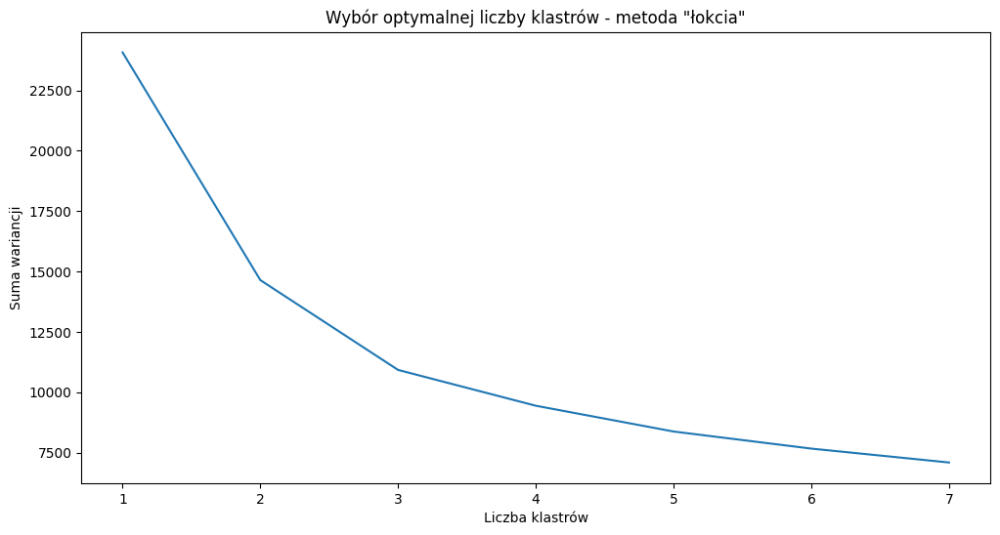

In [ ]:
plot_kmeans(scaled_df_2023_7, 8, 123)

In [ ]:
output_df_2023_7 = do_kmeans_and_return_df_with_cluster_column(df_2023_7, scaled_df_2023_7, 4, 123)

### 1.2. Kolumny z PCA

In [ ]:
SparkDataFrame_2023_7_pca = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 2023) and (Month == 7)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
df_2023_7_pca = SparkDataFrame_2023_7_pca.toPandas()

In [ ]:
# Standaryzacja
standarized_df_2023_7_pca = StandardScaler().fit_transform(df_2023_7_pca.drop(columns=["Month", "lon", "lat", "Year"]))
# PCA
pca = PCA(n_components=2)
standarized_df_2023_7_pca_done = pca.fit_transform(standarized_df_2023_7_pca)

In [ ]:
# Wyjaśniona wariancja
pca.explained_variance_ratio_

array([0.47492985, 0.21441256])

In [ ]:
standarized_df_2023_7_pca_done = pd.DataFrame(data = standarized_df_2023_7_pca_done, columns = ['principal component 1', 'principal component 2'])

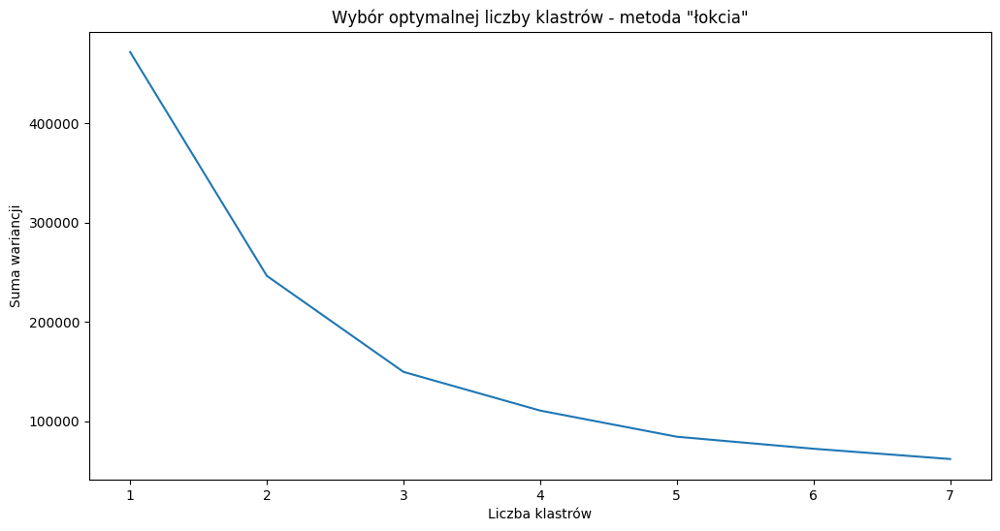

In [ ]:
plot_kmeans(standarized_df_2023_7_pca_done, 8, 123)

In [ ]:
output_df_2023_7_pca = do_kmeans_and_return_df_with_cluster_column(df_2023_7_pca, standarized_df_2023_7_pca_done, 4, 123)

## 2. Dane z 01.01.2023

### 2.1 Kolumny: Evap, Rainf, AvgSurfT, Albedo, SoilM_100_200cm, GVEG, PotEvap, RootMoist, SoilT_10_40cm.

In [ ]:
SparkDataFrame_2023_1 = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 2023) and (Month == 1)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
df_2023_1 = SparkDataFrame_2023_1.toPandas()

In [ ]:
scaled_df_2023_1 = MinMaxScaling(df_2023_1, ['Evap', 'Rainf', 'AvgSurfT', 'Albedo', 'SoilM_100_200cm', 'GVEG', 'PotEvap', 'RootMoist', 'SoilT_10_40cm'])

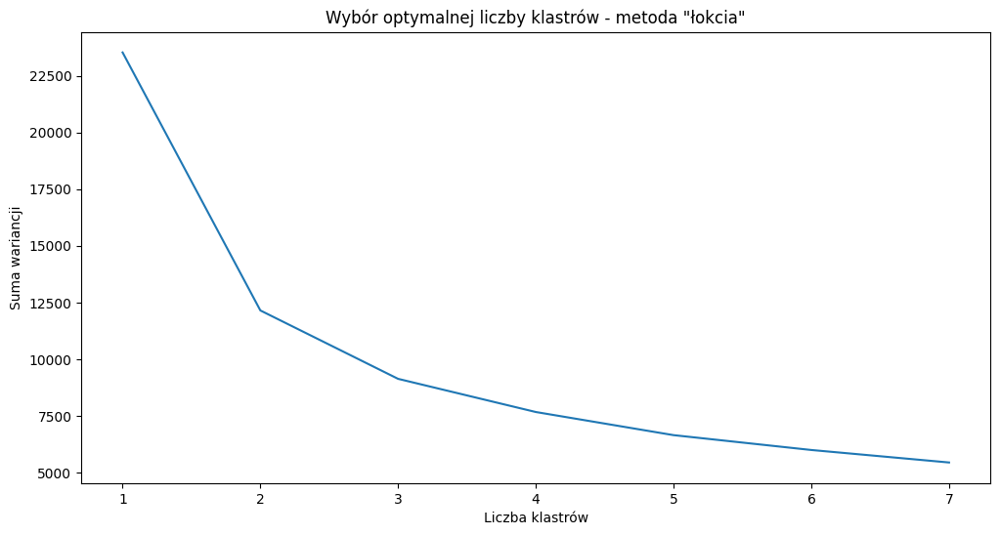

In [ ]:
plot_kmeans(scaled_df_2023_1, 8, 123)

In [ ]:
output_df_2023_1 = do_kmeans_and_return_df_with_cluster_column(df_2023_1, scaled_df_2023_1, 4, 123)

### 2.2 Kolumny z PCA

In [ ]:
SparkDataFrame_2023_1_pca = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 2023) and (Month == 1)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
df_2023_1_pca = SparkDataFrame_2023_1_pca.toPandas()

In [ ]:
standarized_df_2023_1_pca = StandardScaler().fit_transform(df_2023_1_pca.drop(columns=["Month", "lon", "lat", "Year"]))

pca = PCA(n_components=2)
standarized_df_2023_1_pca_done = pca.fit_transform(standarized_df_2023_1_pca)

In [ ]:
pca.explained_variance_ratio_

array([0.53747594, 0.21708739])

In [ ]:
standarized_df_2023_1_pca_done = pd.DataFrame(data = standarized_df_2023_1_pca_done, columns = ['principal component 1', 'principal component 2'])

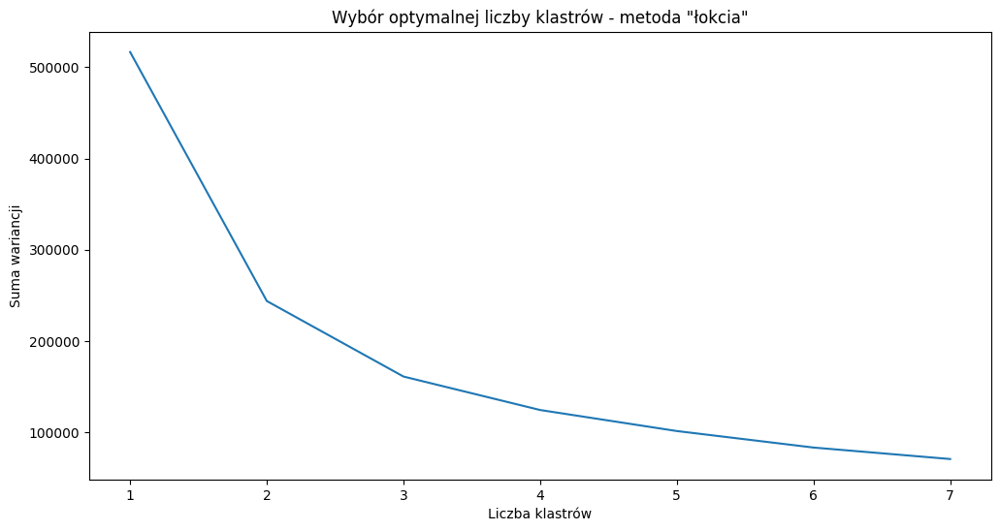

In [ ]:
plot_kmeans(standarized_df_2023_1_pca_done, 8, 123)

In [ ]:
output_df_2023_1_pca = do_kmeans_and_return_df_with_cluster_column(df_2023_1_pca, standarized_df_2023_1_pca_done, 4, 123)

## 3. Dane z 01.07.2000

### 3.1. Kolumny: Evap, Rainf, AvgSurfT, Albedo, SoilM_100_200cm, GVEG, PotEvap, RootMoist, SoilT_10_40cm.

In [ ]:
SparkDataFrame_2000_7 = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 2000) and (Month == 7)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
df_2000_7 = SparkDataFrame_2000_7.toPandas()

In [ ]:
scaled_df_2000_7 = MinMaxScaling(df_2000_7, ['Evap', 'Rainf', 'AvgSurfT', 'Albedo', 'SoilM_100_200cm', 'GVEG', 'PotEvap', 'RootMoist', 'SoilT_10_40cm'])

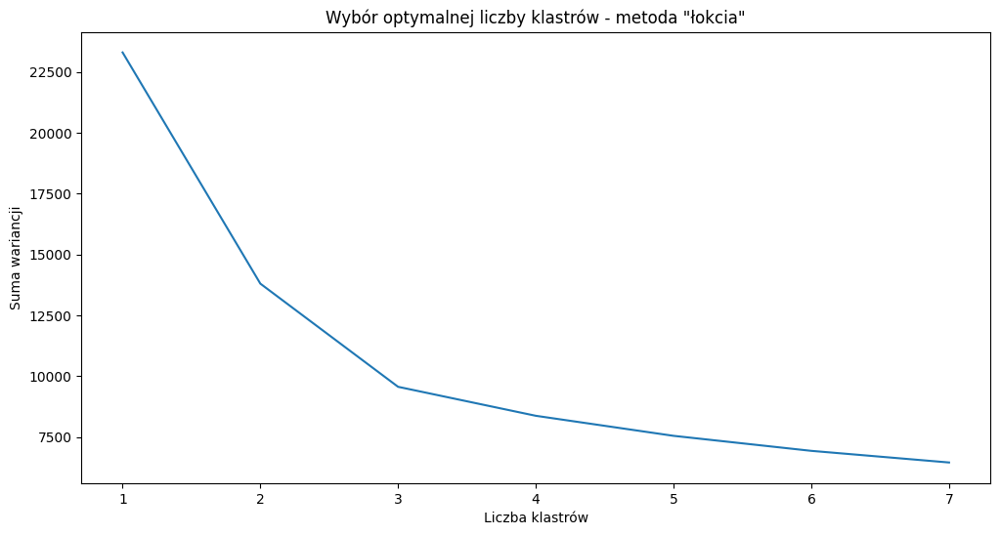

In [ ]:
plot_kmeans(scaled_df_2000_7, 8, 123)

In [ ]:
output_df_2000_7 = do_kmeans_and_return_df_with_cluster_column(df_2000_7, scaled_df_2000_7, 4, 123)

### 3.2. Kolumny z PCA

In [ ]:
SparkDataFrame_2000_7_pca = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 2000) and (Month == 7)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
df_2000_7_pca = SparkDataFrame_2000_7_pca.toPandas()

In [ ]:
# Standaryzacja
standarized_df_2000_7_pca = StandardScaler().fit_transform(df_2000_7_pca.drop(columns=["Month", "lon", "lat", "Year"]))
# PCA
pca = PCA(n_components=3)
standarized_df_2000_7_pca_done = pca.fit_transform(standarized_df_2000_7_pca)

In [ ]:
# Wyjaśniona wariancja
pca.explained_variance_ratio_

array([0.50314246, 0.21501968, 0.09305562])

In [ ]:
standarized_df_2000_7_pca_done = pd.DataFrame(data = standarized_df_2000_7_pca_done, columns = ['principal component 1', 'principal component 2', 'principal component 3'])

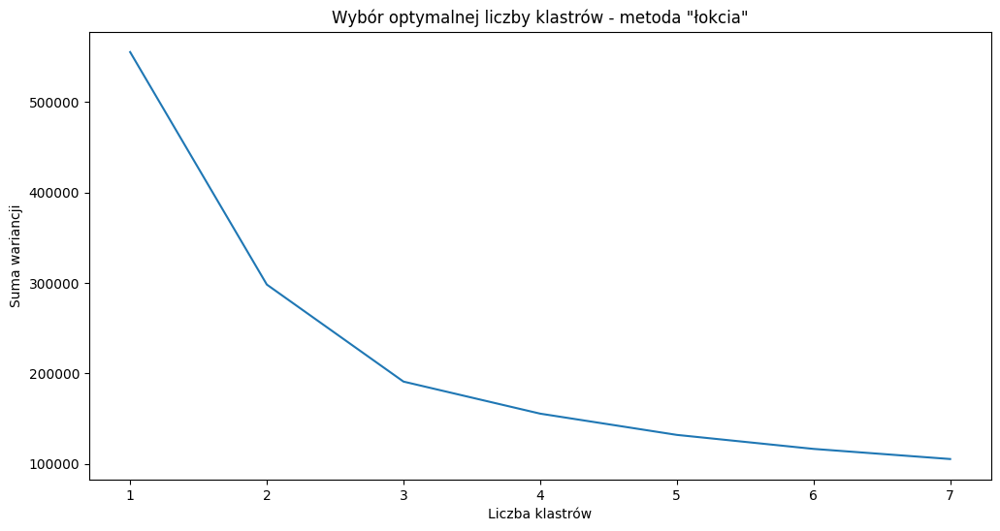

In [ ]:
plot_kmeans(standarized_df_2000_7_pca_done, 8, 123)

In [ ]:
output_df_2000_7_pca = do_kmeans_and_return_df_with_cluster_column(df_2000_7_pca, standarized_df_2000_7_pca_done, 4, 123)

## 4. Dane z 01.01.2000

### 4.1. Kolumny: Evap, Rainf, AvgSurfT, Albedo, SoilM_100_200cm, GVEG, PotEvap, RootMoist, SoilT_10_40cm.



In [ ]:
SparkDataFrame_2000_1 = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 2000) and (Month == 1)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
df_2000_1 = SparkDataFrame_2000_1.toPandas()

In [ ]:
scaled_df_2000_1 = MinMaxScaling(df_2000_1, ['Evap', 'Rainf', 'AvgSurfT', 'Albedo', 'SoilM_100_200cm', 'GVEG', 'PotEvap', 'RootMoist', 'SoilT_10_40cm'])

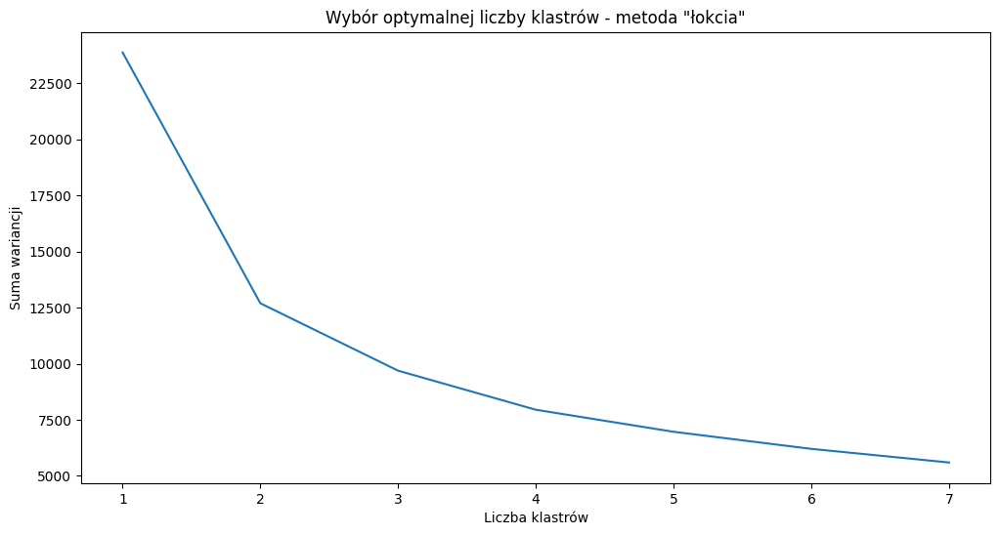

In [ ]:
plot_kmeans(scaled_df_2000_1, 8, 123)

In [ ]:
output_df_2000_1 = do_kmeans_and_return_df_with_cluster_column(df_2000_1, scaled_df_2000_1, 4, 123)

### 4.2. Kolumny z PCA

In [ ]:
SparkDataFrame_2000_1_pca = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 2000) and (Month == 1)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
df_2000_1_pca = SparkDataFrame_2000_1_pca.toPandas()

In [ ]:
standarized_df_2000_1_pca = StandardScaler().fit_transform(df_2000_1_pca.drop(columns=["Month", "lon", "lat", "Year"]))

pca = PCA(n_components=2)
standarized_df_2000_1_pca_done = pca.fit_transform(standarized_df_2000_1_pca)

In [ ]:
pca.explained_variance_ratio_

array([0.50522291, 0.22478276])

In [ ]:
standarized_df_2000_1_pca_done = pd.DataFrame(data = standarized_df_2000_1_pca_done, columns = ['principal component 1', 'principal component 2'])

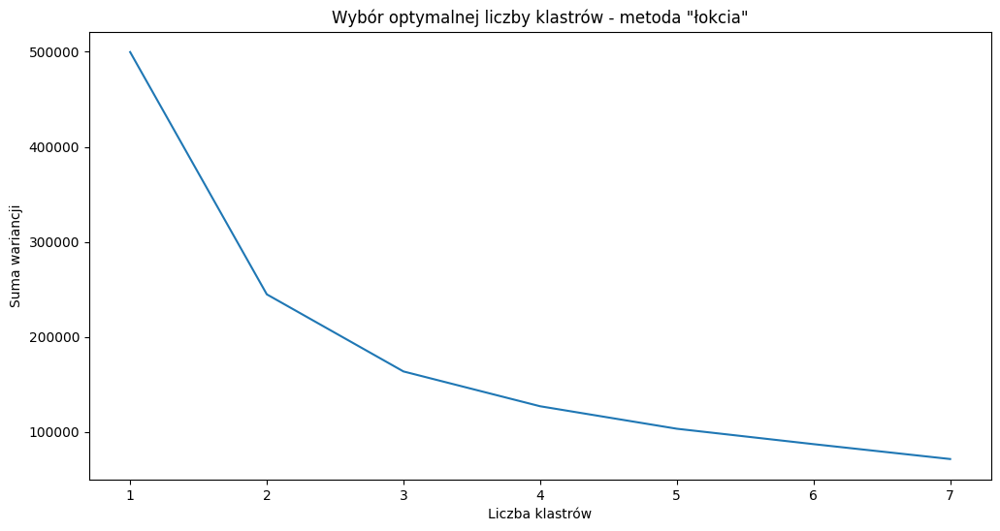

In [ ]:
plot_kmeans(standarized_df_2000_1_pca_done, 8, 123)

In [ ]:
output_df_2000_1_pca = do_kmeans_and_return_df_with_cluster_column(df_2000_1_pca, standarized_df_2000_1_pca_done, 4, 123)

## 5. Dane z 01.07.1979

### 5.1. Kolumny: Evap, Rainf, AvgSurfT, Albedo, SoilM_100_200cm, GVEG, PotEvap, RootMoist, SoilT_10_40cm.

In [ ]:
SparkDataFrame_1979_7 = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 1979) and (Month == 7)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
df_1979_7 = SparkDataFrame_1979_7.toPandas()

In [ ]:
scaled_df_1979_7 = MinMaxScaling(df_1979_7, ['Evap', 'Rainf', 'AvgSurfT', 'Albedo', 'SoilM_100_200cm', 'GVEG', 'PotEvap', 'RootMoist', 'SoilT_10_40cm'])

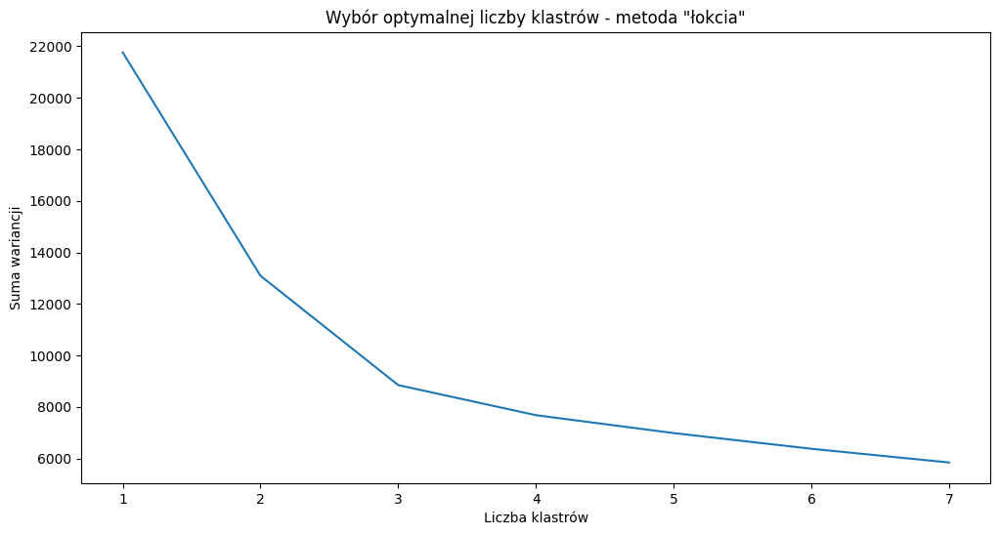

In [ ]:
plot_kmeans(scaled_df_1979_7, 8, 123)

In [ ]:
output_df_1979_7 = do_kmeans_and_return_df_with_cluster_column(df_1979_7, scaled_df_1979_7, 4, 123)

### 5.2. Kolumny z PCA

In [ ]:
SparkDataFrame_1979_7_pca = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 1979) and (Month == 7)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
df_1979_7_pca = SparkDataFrame_1979_7_pca.toPandas()

In [ ]:
# Standaryzacja
standarized_df_1979_7_pca = StandardScaler().fit_transform(df_1979_7_pca.drop(columns=["Month", "lon", "lat", "Year"]))
# PCA
pca = PCA(n_components=3)
standarized_df_1979_7_pca_done = pca.fit_transform(standarized_df_1979_7_pca)

In [ ]:
# Wyjaśniona wariancja
pca.explained_variance_ratio_

array([0.43944904, 0.27533773, 0.08585149])

In [ ]:
standarized_df_1979_7_pca_done = pd.DataFrame(data = standarized_df_1979_7_pca_done, columns = ['principal component 1', 'principal component 2', 'principal component 3'])

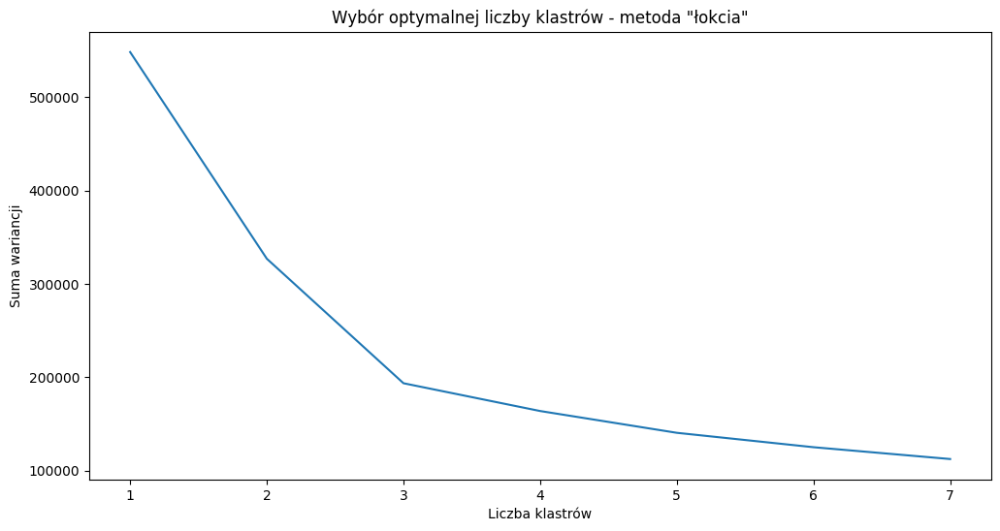

In [ ]:
plot_kmeans(standarized_df_1979_7_pca_done, 8, 123)

In [ ]:
output_df_1979_7_pca = do_kmeans_and_return_df_with_cluster_column(df_1979_7_pca, standarized_df_1979_7_pca_done, 4, 123)

## 6. Dane z 01.01.1979

### 6.1. Kolumny: Evap, Rainf, AvgSurfT, Albedo, SoilM_100_200cm, GVEG, PotEvap, RootMoist, SoilT_10_40cm.



In [ ]:
SparkDataFrame_1979_1 = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 1979) and (Month == 1)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
df_1979_1 = SparkDataFrame_1979_1.toPandas()

In [ ]:
scaled_df_1979_1 = MinMaxScaling(df_1979_1, ['Evap', 'Rainf', 'AvgSurfT', 'Albedo', 'SoilM_100_200cm', 'GVEG', 'PotEvap', 'RootMoist', 'SoilT_10_40cm'])

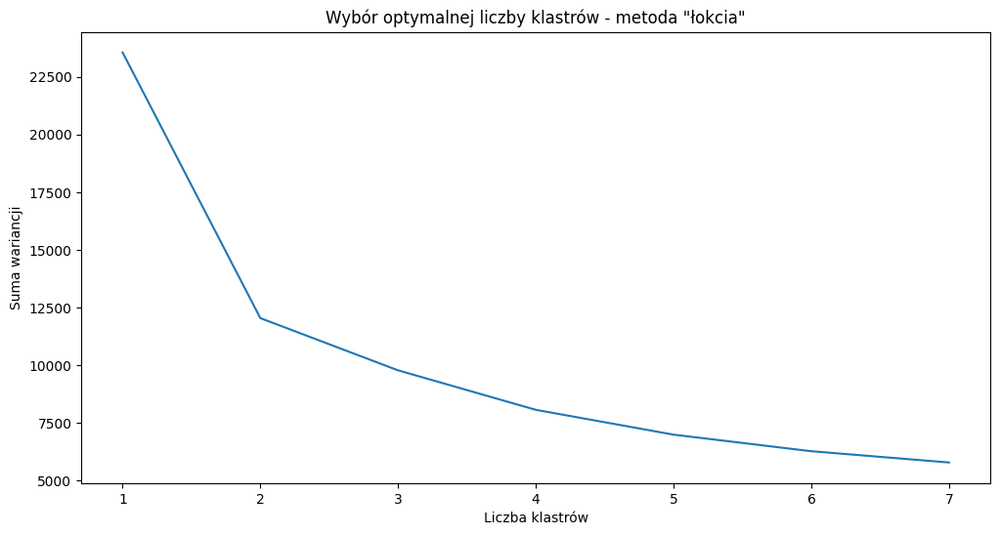

In [ ]:
plot_kmeans(scaled_df_1979_1, 8, 123)

In [ ]:
output_df_1979_1 = do_kmeans_and_return_df_with_cluster_column(df_1979_1, scaled_df_1979_1, 4, 123)

### 6.2. Kolumny z PCA

In [ ]:
SparkDataFrame_1979_1_pca = spark.sql("""
                        SELECT
                        *
                        FROM nasa_ym WHERE (Year == 1979) and (Month == 1)
                        order by lon, lat, Year, Month
                        """)

In [ ]:
df_1979_1_pca = SparkDataFrame_1979_1_pca.toPandas()

In [ ]:
standarized_df_1979_1_pca = StandardScaler().fit_transform(df_1979_1_pca.drop(columns=["Month", "lon", "lat", "Year"]))

pca = PCA(n_components=2)
standarized_df_1979_1_pca_done = pca.fit_transform(standarized_df_1979_1_pca)

In [ ]:
pca.explained_variance_ratio_

array([0.58915297, 0.18655177])

In [ ]:
standarized_df_1979_1_pca_done = pd.DataFrame(data = standarized_df_1979_1_pca_done, columns = ['principal component 1', 'principal component 2'])

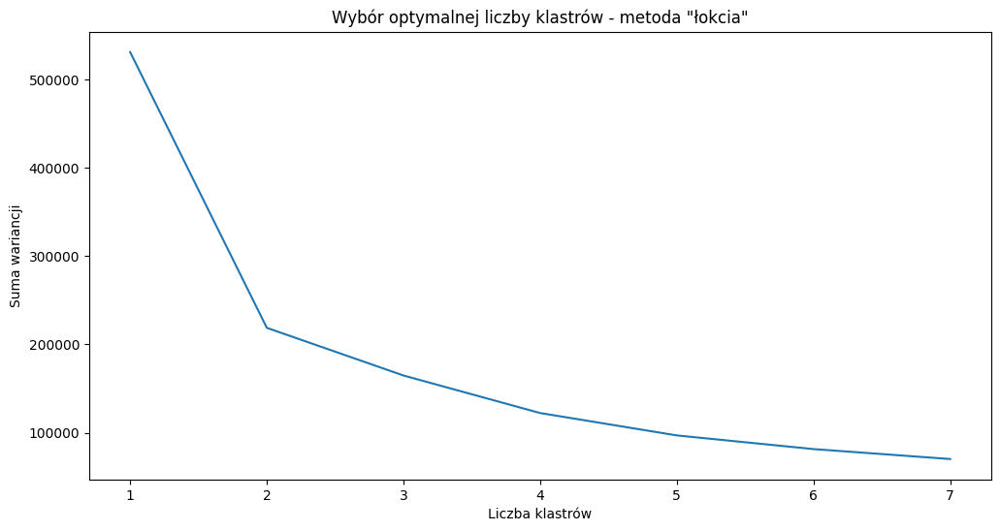

In [ ]:
plot_kmeans(standarized_df_1979_1_pca_done, 8, 123)

In [ ]:
output_df_1979_1_pca = do_kmeans_and_return_df_with_cluster_column(df_1979_1_pca, standarized_df_1979_1_pca_done, 4, 123)

# Graficzne przedstawienie klastrów

In [ ]:
!pip install datashader

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 27.2 MB/s eta 0:00:00


In [ ]:
!pip install holoviews hvplot colorcet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 26.9 MB/s eta 0:00:00


In [ ]:
!pip install geoviews

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.2/511.2 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 19.1 MB/s eta 0:00:00


In [ ]:
import numpy as np
import matplotlib as mpl

In [ ]:
import datashader as ds
import datashader.transfer_functions as tf
import colorcet as cc
import holoviews as hv
from holoviews.operation.datashader import datashade
import geoviews as gv
import geoviews.tile_sources as gts
from holoviews import opts
from IPython.display import IFrame
from IPython.core.display import display
from bokeh.plotting import show, output_notebook

In [ ]:
'''
Funkcja jako argumenty bierze listę wartości określających granice przedziałów liczbowych, które
będą określać jak dla rozważanego parametru mają zmieniać się kolory punktów, których lista stanowi
drugi argument funkcji.
'''
def get_colormap(values: list, colors_palette: list, name = 'custom'):
    values = np.sort(np.array(values))
    values = np.interp(values, (values.min(), values.max()), (0, 1))
    cmap = mpl.colors.LinearSegmentedColormap.from_list(name, list(zip(values, colors_palette)))
    return cmap

In [ ]:
def plot_map(df: pd.DataFrame, parameter_name: str, colormap: mpl.colors.LinearSegmentedColormap,
             point_size: int = 8, width: int = 800, height: int = 500, alpha: float = 1,
             bgcolor: str = 'white'):

    gdf = gv.Points(df, ['lon', 'lat'], [parameter_name]) # obiekt zawierający punkty
    tiles = gts.OSM # wybór mapy tła, w tym wypadku OpenStreetMap

    # łączenie mapy tła z punktami i ustawienie wybranych parametrów wizualizacji
    map_with_points = tiles * gdf.opts(
        color=parameter_name,
        cmap=colormap,
        size=point_size,
        width=width,
        height=height,
        colorbar=True,
        toolbar='above',
        tools=['hover', 'wheel_zoom', 'reset'],
        alpha=alpha, # przezroczystość
        bgcolor=bgcolor
    )

    return hv.render(map_with_points)

In [ ]:
display(IFrame("https://www.google.com/maps/embed?pb=!1m14!1m12!1m3!1d13982681.959428234!2d-98.66341902257437!3d38.39997874427714!2m3!1f0!2f0!3f0!3m2!1i1024!2i768!4f13.1!5e1!3m2!1spl!2spl!4v1703000232420!5m2!1spl!2spl", '800px', '500px'))

In [ ]:
colormap_cluster = get_colormap([0, max(output_df_2023_7.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_2023_7, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
colormap_cluster = get_colormap([0, max(output_df_2023_7_pca.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_2023_7_pca, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
colormap_cluster = get_colormap([0, max(output_df_2023_1.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_2023_1, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
colormap_cluster = get_colormap([0, max(output_df_2023_1_pca.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_2023_1_pca, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
colormap_cluster = get_colormap([0, max(output_df_2000_7.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_2000_7, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
colormap_cluster = get_colormap([0, max(output_df_2000_7_pca.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_2000_7_pca, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
colormap_cluster = get_colormap([0, max(output_df_2000_1.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_2000_1, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
colormap_cluster = get_colormap([0, max(output_df_2000_1_pca.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_2000_1_pca, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
colormap_cluster = get_colormap([0, max(output_df_1979_7.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_1979_7, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
colormap_cluster = get_colormap([0, max(output_df_1979_7_pca.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_1979_7_pca, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
colormap_cluster = get_colormap([0, max(output_df_1979_1.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_1979_1, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
colormap_cluster = get_colormap([0, max(output_df_1979_1_pca.cluster.values)], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=output_df_1979_1_pca, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
output_df_1979_7.head()

,Year,Month,lon,lat,Rainf,Evap,AvgSurfT,Albedo,SoilT_10_40cm,GVEG,PotEvap,RootMoist,SoilM_100_200cm,cluster
0,1979,7,-124.9375,48.8125,45.480801,38.988136,286.528076,19.786291,282.233124,0.853646,188.309753,458.287292,232.821716,2
1,1979,7,-124.9375,48.9375,46.629879,51.380627,288.446960,19.526882,283.746857,0.853646,226.713058,446.453827,225.477402,2
2,1979,7,-124.9375,49.0625,49.213120,49.203781,287.449738,19.388441,282.670349,0.862553,241.283813,451.732849,228.292618,2
3,1979,7,-124.9375,49.1875,55.396297,52.739601,288.308533,19.384409,283.313690,0.862553,247.471252,454.707825,229.158920,2
4,1979,7,-124.9375,49.3125,59.471508,65.268486,290.856598,19.380377,285.867004,0.854944,245.478806,443.494324,220.538544,2


In [ ]:
output_df_2000_7.head()

,Year,Month,lon,lat,Rainf,Evap,AvgSurfT,Albedo,SoilT_10_40cm,GVEG,PotEvap,RootMoist,SoilM_100_200cm,cluster
0,2000,7,-124.9375,48.8125,33.737598,30.515594,286.101837,19.810484,282.080994,0.854482,176.576828,452.630035,237.585663,0
1,2000,7,-124.9375,48.9375,36.766502,41.665581,287.759674,19.559139,283.523071,0.854482,208.732529,443.978455,232.739777,0
2,2000,7,-124.9375,49.0625,41.888409,42.057205,286.598053,19.419355,282.676086,0.863198,219.746185,443.383850,231.233749,0
3,2000,7,-124.9375,49.1875,50.236488,45.802097,287.430176,19.416666,283.377472,0.863198,224.858856,439.510254,227.410721,0
4,2000,7,-124.9375,49.3125,54.965992,56.383820,290.199738,19.411291,285.577850,0.855618,223.318756,429.405487,220.939514,0


In [ ]:
output_df_2023_7.head()

,Year,Month,lon,lat,Rainf,Evap,AvgSurfT,Albedo,SoilT_10_40cm,GVEG,PotEvap,RootMoist,SoilM_100_200cm,cluster
0,2023,7,-124.9375,48.8125,52.833260,35.829731,286.131409,19.786289,282.348999,0.853646,179.818802,453.129303,229.709702,3
1,2023,7,-124.9375,48.9375,38.926411,46.269798,288.296814,19.526880,284.222412,0.853646,224.151093,416.851501,212.187302,3
2,2023,7,-124.9375,49.0625,28.727079,43.290890,287.673187,19.388439,283.765198,0.862553,249.848099,404.108093,209.352905,3
3,2023,7,-124.9375,49.1875,22.068300,45.769100,288.770599,19.384411,284.735596,0.862553,265.357788,391.540192,204.505798,3
4,2023,7,-124.9375,49.3125,19.899300,54.683681,291.387085,19.380381,286.933685,0.854944,263.761688,371.704895,194.539795,3


# Porównanie punktów z 01.07.2023, 01.07.2000 i 01.07.1979.

In [ ]:
merged_to_2023_7 = output_df_2023_7
merged_to_2023_7["cluster_2000"] = output_df_2000_7["cluster"].apply(lambda x: int(0) if x==3 else (int(2) if x==1 else (int(1) if x==2 else int(3))))
merged_to_2023_7["cluster_1979"] = output_df_1979_7["cluster"].apply(lambda x: int(0) if x==3 else (int(2) if x==0 else (int(3) if x==2 else int(1))))
merged_to_2023_7.head(10)

,Year,Month,lon,lat,Rainf,Evap,AvgSurfT,Albedo,SoilT_10_40cm,GVEG,PotEvap,RootMoist,SoilM_100_200cm,cluster,cluster_2000,cluster_1979
0,2023,7,-124.9375,48.8125,52.833260,35.829731,286.131409,19.786289,282.348999,0.853646,179.818802,453.129303,229.709702,3,3,3
1,2023,7,-124.9375,48.9375,38.926411,46.269798,288.296814,19.526880,284.222412,0.853646,224.151093,416.851501,212.187302,3,3,3
2,2023,7,-124.9375,49.0625,28.727079,43.290890,287.673187,19.388439,283.765198,0.862553,249.848099,404.108093,209.352905,3,3,3
3,2023,7,-124.9375,49.1875,22.068300,45.769100,288.770599,19.384411,284.735596,0.862553,265.357788,391.540192,204.505798,3,3,3
4,2023,7,-124.9375,49.3125,19.899300,54.683681,291.387085,19.380381,286.933685,0.854944,263.761688,371.704895,194.539795,3,3,3
5,2023,7,-124.9375,49.4375,20.608200,38.106880,287.512909,19.376341,283.118500,0.848743,233.223907,411.171997,214.318100,3,3,3
6,2023,7,-124.9375,49.5625,33.777000,55.408669,291.305695,19.375000,286.707214,0.848743,246.602203,385.813110,198.538498,3,3,3
7,2023,7,-124.9375,49.6875,51.993011,61.937931,292.905396,19.370970,287.394104,0.848743,246.611404,434.710297,217.206299,3,3,3
8,2023,7,-124.9375,50.1875,99.177612,65.686920,291.982605,19.372311,287.727997,0.760670,239.876602,422.167999,205.041397,3,3,3
9,2023,7,-124.9375,50.3125,101.502602,63.850979,290.506104,19.377689,286.615692,0.716982,240.854294,437.771088,213.798492,3,3,3


Sprawdźmy, które punkty były zakwalifikowane jako te niepustynne znajdujące się najbliżej pustyni w lipcu 2000, a stały się pustynią w lipcu 2023.

In [ ]:
df_from_not_desert_to_desert = merged_to_2023_7.loc[(merged_to_2023_7["cluster"]==0) & (merged_to_2023_7["cluster_2000"]==2)].dropna()

In [ ]:
df_from_not_desert_to_desert

,Year,Month,lon,lat,Rainf,Evap,AvgSurfT,Albedo,SoilT_10_40cm,GVEG,PotEvap,RootMoist,SoilM_100_200cm,cluster,cluster_2000,cluster_1979
1560,2023,7,-122.5625,40.3125,0.000000,40.652069,300.524689,27.939520,293.189209,0.420093,474.093597,357.835785,189.119400,0,2,0
1672,2023,7,-122.4375,39.8125,0.399000,42.805462,299.578888,32.366940,292.606995,0.447407,487.173401,360.727814,191.399002,0,2,0
1677,2023,7,-122.4375,40.4375,0.000000,51.451679,300.748810,27.143820,293.312408,0.427445,480.713196,332.131897,175.262100,0,2,0
1795,2023,7,-122.3125,40.4375,0.000000,41.960129,301.093994,28.107531,293.527100,0.428744,487.329987,356.664703,188.363602,0,2,0
1921,2023,7,-122.1875,40.4375,0.000000,42.043560,301.040588,29.172041,293.456390,0.428744,494.823792,359.891296,190.201096,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64136,2023,7,-80.9375,26.0625,156.259995,73.866829,306.374908,22.674730,304.400299,0.280247,260.721588,154.101807,192.674301,0,2,0
66795,2023,7,-78.6875,26.5625,73.067467,71.273323,305.444000,22.974461,301.155090,0.076121,249.291306,262.338715,302.339996,0,2,0
66942,2023,7,-78.5625,26.6875,131.222794,78.406029,305.221313,23.005381,300.915314,0.076121,242.150208,275.224792,323.087891,0,2,0
68408,2023,7,-77.3125,26.0625,84.646606,72.428940,304.723114,23.181450,300.411102,0.085148,240.789902,266.800812,312.999390,0,2,0


In [ ]:
colormap_cluster = get_colormap([0, 1], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=df_from_not_desert_to_desert, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


Sprawdźmy, które punkty były zakwalifikowane jako te niepustynne znajdujące się najbliżej pustyni w lipcu 1979, a stały się pustynią w lipcu 2023.

In [ ]:
df_from_not_desert_to_desert = merged_to_2023_7.loc[(merged_to_2023_7["cluster"]==0) & (merged_to_2023_7["cluster_1979"]==2)].dropna()
df_from_not_desert_to_desert

,Year,Month,lon,lat,Rainf,Evap,AvgSurfT,Albedo,SoilT_10_40cm,GVEG,PotEvap,RootMoist,SoilM_100_200cm,cluster,cluster_2000,cluster_1979
4263,2023,7,-120.0625,36.4375,0.000000,15.783620,303.643585,27.103491,295.657806,0.613148,423.422089,127.849602,277.201904,0,0,2
4264,2023,7,-120.0625,36.5625,0.000000,12.161310,302.005615,26.478491,292.659485,0.613148,443.772614,52.067760,171.868607,0,0,2
4410,2023,7,-119.9375,36.5625,0.000000,13.854210,302.063202,26.372311,292.286011,0.603130,446.131287,53.177910,193.869904,0,0,2
5385,2023,7,-119.1875,46.6875,2.319901,12.223500,299.920593,25.713711,292.899506,0.533773,371.642700,86.546883,119.619499,0,2,2
11413,2023,7,-114.6875,42.9375,0.023500,20.210609,299.489410,31.952959,291.076508,0.503553,375.244507,37.205521,120.228302,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62638,2023,7,-81.9375,26.5625,13.105500,25.958599,305.934113,23.751341,302.981506,0.354902,217.577103,35.851170,117.635902,0,2,2
62639,2023,7,-81.9375,26.6875,47.391010,68.367668,305.175293,23.797041,302.899689,0.393605,215.922394,101.284798,124.093300,0,2,2
62823,2023,7,-81.8125,26.1875,21.430401,39.042011,304.189697,23.438169,302.628204,0.384769,255.285706,112.653801,22.996679,0,2,2
63766,2023,7,-81.1875,25.8125,113.029602,81.016579,306.692596,23.102150,303.896393,0.315164,276.554291,143.667206,175.769394,0,2,2


In [ ]:
colormap_cluster = get_colormap([0, 1], ['yellow', 'darkgreen'])
output_notebook()
show(plot_map(df=df_from_not_desert_to_desert, parameter_name='cluster', colormap=colormap_cluster, alpha=0.5))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


In [ ]:
display(IFrame("https://www.google.com/maps/embed?pb=!1m14!1m12!1m3!1d13982681.959428234!2d-98.66341902257437!3d38.39997874427714!2m3!1f0!2f0!3f0!3m2!1i1024!2i768!4f13.1!5e1!3m2!1spl!2spl!4v1703000232420!5m2!1spl!2spl", '800px', '500px'))